In [ ]:
#Python Decorators in plain English

# Python decorators are steriods for functions. They add pluggable functionality to existing functions. They are a way to modify functions using other functions. This is ideal when you need to extend the functionality of functions that you don't want to modify.

# Enough of talk let us dive into solving real world problems using decorators.

# Suppose you have a very simple function that generates a random number between 0 and 1.

In [7]:
from random import random

def returnRandomNumber():
    return random()
  
returnRandomNumber()

0.6798951143772883

In [27]:
# The function just returns one random number. But what if you want to return a list of random numbers? Let us create and plug a decorator to do that.

def returnListOfRandomNumbers(func):
    def wrapper():
        return [func() for i in range(10)]
    return wrapper

In [ ]:
# It is important to understand the structure of a decorator. A decorator is a function that takes another function as an argument and returns a function. 
# The function that is passed as an argument is called the wrapped function. The function that is returned by the decorator is called the wrapper function.
# Phew! That was mounthful. Let us see how it works.

# The function generateNumbers is a decorator function that takes another function as an argument. In this case the function is returnRandomNumber. 
# Inside the decorator function we define another function which we call as a wrapper function. The wrapper function just calls the function that is passed as an argument 10 times, thereby returning a list of 10 random numbers in this specific case. In fact, it will call any function that is passed as an argument 10 times.

# Now we decorate the returnRandomNumber function with the generateNumbers decorator.

In [28]:
from random import random

@generateNumbers
def returnRandomNumber():
    return random()
  
returnRandomNumber()

[0.020995700935664274,
 0.47713720992685915,
 0.1894676214617821,
 0.9856450090027941,
 0.6331524381427598,
 0.6825774661062789,
 0.4884866139903554,
 0.05740839026587918,
 0.07816772740464417,
 0.5911752982096037]

In [29]:
# The decorator generateNumbers is plug and play. It will take any arbitrary function and call it 10 times and return a list of 10 rerturn values.
i=0
@generateNumbers
def callMe10Times():
  global i
  i += 1
  return "I was called {} times".format(i)
  i = i+1
  
callMe10Times()

['I was called 1 times',
 'I was called 2 times',
 'I was called 3 times',
 'I was called 4 times',
 'I was called 5 times',
 'I was called 6 times',
 'I was called 7 times',
 'I was called 8 times',
 'I was called 9 times',
 'I was called 10 times']

In [23]:
# So now you can see how we added a pluggable super=power to our existing function returnRandomNumber without modifying it. Right now, we hard-coded the number of random numbers to be returned. But we can make it more flexible by passing the number of random numbers to be returned as an argument to our original returnRandomNumber function. Let us see how.

def returnRandomNumber(num: int) -> list:
    return [random() for _ in range(num)]

In [32]:
# Now we need to modify our decorator as well to accept any number of arguments that are passed to the original function.

def generateNumbers(func):
    def wrapper(*args, **kwargs):
        return [func(*args, **kwargs) for _ in range(10)]
    return wrapper

# *args stands for arbitrary arguments and **kwargs stands for arbitrary keyword arguments. So now the wrapped function can accept any number of arguments and keyword arguments. 

@generateNumbers
def returnRandomNumber(num: int) -> list:
    return [random() for _ in range(num)]


returnRandomNumber(5)

[[0.08559955152501708,
  0.9718416554139274,
  0.39390535172320473,
  0.5007878709751988,
  0.2904996166883561],
 [0.04491038332900443,
  0.4009300116608011,
  0.5174940304561041,
  0.8486072122975843,
  0.546762466146969],
 [0.33939166877044646,
  0.5834463362405352,
  0.13199682977525795,
  0.6626902063017246,
  0.24552893076154092],
 [0.5379811952127296,
  0.23801629106359368,
  0.49290958234996873,
  0.04514744725354014,
  0.5841313987368992],
 [0.739792987404503,
  0.8321543899352288,
  0.587728903478607,
  0.6387874478866729,
  0.1496719621594319],
 [0.4836619522663471,
  0.27014620314035287,
  0.6377149676711398,
  0.42940433098776587,
  0.127114842961345],
 [0.09911291320403026,
  0.038477571927013954,
  0.24355589135639388,
  0.7965029424816807,
  0.7274874350311216],
 [0.12208049587344905,
  0.118225063351308,
  0.6209899772003205,
  0.9147566731861737,
  0.571824046450836],
 [0.2554511955750679,
  0.6155333038544584,
  0.5894841265812232,
  0.4896660914260228,
  0.1693603718

In [ ]:
# We generated 10 list of 5 random numbers. But what if we want to generate 1000 lists of 1000 random numbers? We can do that by passing the number of lists as an argument to the decorator.

In [41]:
def ListOfRandomNumbers (numOfIterations: int):
    def generateNumbers(func):
        def wrapper(*args, **kwargs):
            return [func(*args, **kwargs) for _ in range(numOfIterations)]
        return wrapper
    return  generateNumbers

@ListOfRandomNumbers(numOfIterations = 1000)
def returnRandomNumber(num: int) -> list:
    return [random() for _ in range(num)]

returnRandomNumber(1000)

[[0.4347985482784468,
  0.38338929272631483,
  0.8477767004610963,
  0.5410907753895348,
  0.556274055076242,
  0.9236106080134058,
  0.1564735105204993,
  0.025733949010279367,
  0.05717585178174378,
  0.019990356328071557,
  0.4013643166849007,
  0.4095203698668576,
  0.4635665497664532,
  0.16273250939477102,
  0.7448959999042608,
  0.24837611318894381,
  0.9576040984478799,
  0.04972341603264174,
  0.33293315066427676,
  0.25963364090268115,
  0.10976225962325026,
  0.6963841893751566,
  0.18147508815663538,
  0.7520920959124415,
  0.25347245897445503,
  0.7134359358256959,
  0.7877383204643994,
  0.5677363192012425,
  0.5429315179360157,
  0.6992382693391689,
  0.6398306629090901,
  0.902277554300834,
  0.5472864590924326,
  0.45408813540384196,
  0.38678489159133156,
  0.3482187700474627,
  0.23922533932641998,
  0.7497898573649185,
  0.8842502015533449,
  0.6949804895832867,
  0.16994274347003602,
  0.7086004943036313,
  0.1605241481719556,
  0.7591773589035458,
  0.041501297656

In [ ]:
# Pause and reflect on what is happening! The decorator has a hierarchy of three functions:

# 1. ListOfRandomNumbers which takes an argument numOfIterations and returns a sub function generateNumbers.
# 2. generateNumbers which takes a wrapped function as an argument and returns a sub function 'wrapper'.
# 3. 'wrapper' calls the wrapped function numOfIterations times and returns a list of return values.

# I know this is seeming like a maze. Just remember this: Wrapped function is the original fucntion that needs super-powers. Wrapper function gives the wrapped function super-powers. Decorator function is the one that plugs the super-powers to the wrapped or the original function.

# Decorator  → Wrapper  →  Wrapped Function

In [43]:
# Now suppose we need to calculate the mean of the each list of random numbers we generated. We can now create another decorator that calculates the mean of the list of random numbers.

def getMeanOfEachList (func):
    def wrapper(*args, **kwargs):
        mean = lambda x: sum(x)/len(x)
        bigList = func(*args, **kwargs)
        return [mean(lst) for lst in bigList]
    return wrapper

[0.49296039931394453,
 0.5024896468622998,
 0.4988418715657069,
 0.4942859165086526,
 0.5046634598242303,
 0.5091690591075492,
 0.5108332241446873,
 0.4923285803606054,
 0.5063265423635686,
 0.5020635200418057,
 0.5091816193751852,
 0.49249582697377914,
 0.48655513474739576,
 0.5101459613582363,
 0.5076578658987645,
 0.5059635590774026,
 0.5054304987442574,
 0.49209327666241387,
 0.5058184589841105,
 0.4905611982905091,
 0.49506828148098087,
 0.4881509258974356,
 0.49307403456995264,
 0.5009793288165934,
 0.4868181023703989,
 0.5071753278719195,
 0.4792873416777757,
 0.4981927115216933,
 0.49593535383200255,
 0.5004869052299331,
 0.4977519596299134,
 0.5068348276623031,
 0.5123104317375153,
 0.5038180422024268,
 0.49904886957343386,
 0.5042585292576505,
 0.48803075240250704,
 0.4929440409055098,
 0.5063974235238028,
 0.49801622797201445,
 0.5014928683744326,
 0.5052532356713482,
 0.5067972763108403,
 0.5146146048866507,
 0.5011150541649316,
 0.5083266491639276,
 0.48771641472307703,
 0

In [ ]:
# Now we can chain these two decorators to get the mean of each list of 1000 random numbers.

In [ ]:
@getMeanOfEachList  
@ListOfRandomNumbers(numOfIterations = 1000)
def returnRandomNumber(num: int) -> list:
    return [random() for _ in range(num)]

returnRandomNumber(1000)

<AxesSubplot: ylabel='Density'>

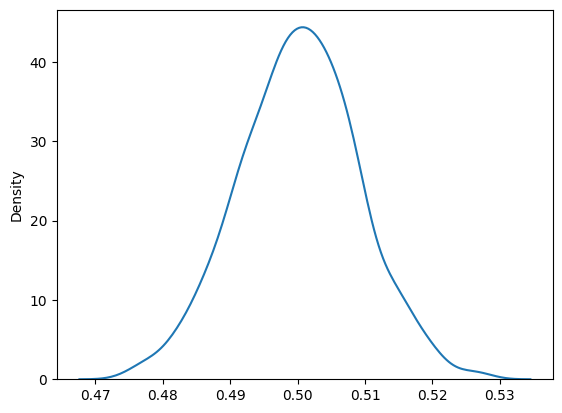

In [45]:
# Let us now plot kernel density of the mean of each list of random numbers.
from seaborn import kdeplot
kdeplot(returnRandomNumber(1000))


In [ ]:
# Congratulations! You just demonstrated the central limit theorem using Python decorators. 